In [2]:
import os
import pygmt
import imageio
import xarray as xr
import numpy as np
from scripts import mapOutputs as mout

# Export to netcdf


> We first export the model outputs as netcdf files. We use `netcdf` files here as they offer more flexibilities and functionalities than `hdf5` ones for sharing and plotting.


![view](img/data.png)

We first define a folder where exported files will be stored:

In [2]:
# Define output folder name for the simulation
out_path = 'export/unconstrained'

if not os.path.exists(out_path):
    os.makedirs(out_path)

Then we will be using the `mapOutputs` Python class to first extract the outputs, remap the unstructured variables on a structured mesh (the resolution of this mesh is defined by the `reso` parameter set in degree). The class is also performing additional calculations on the dataset to extract individual catchments based on flow accumulation and elevation.

The interpolated model's variables are then exported as `netCDF` files, and each of them contains the following:

+ elevation `elevation` (m)
+ cumulative erosion/deposition `erodep` (m)
+ water flux discharge (accounting for lakes) `fillDischarge`(m3/yr)
+ water flux in rivers (not showing lakes) `flowDischarge` (m3/yr)
+ sediment flux in rivers `sedimentLoad` (m3/yr)
+ main basin ids `basinID` (integer)
+ rainfall `precipitation` (m/yr)
+ tectonic `uplift` (m/yr)

In [3]:
stp = 1

# Resolution of the netcdf structured grid
reso = 0.1

# Name of each netcdf output file
ncout = os.path.join(out_path, "data")

# Initialisation of the class
grid = mout.mapOutputs(path='../3-simulations/', filename='unconstrained.yml', step=stp, uplift=True)

We perform the export using the following loop:

In [ ]:
for k in range(95,-1,-5):
    
    if stp>1:
        # Get goSPL variables
        grid.getData(stp)
        
    # Remap the variables on the regular mesh using distance weighting interpolation
    grid.buildLonLatMesh(res=reso, nghb=3)
    
    # Export corresponding regular mesh variables as netCDF file
    grid.exportNetCDF(ncfile = ncout+str(k)+'Ma.nc')
    stp += 1

# Plotting some outputs

In [ ]:
# We chose a time
time = 50

# and open the netCDF file
dataset = xr.open_dataset(out_path+'/data'+str(time)+'Ma.nc')


### Robinson projection

basemap [WARNING]: 6 annotations along the bottom border were skipped due to crowding.
basemap [WARNING]: Crowding decisions is controlled by MAP_ANNOT_MIN_SPACING, currently set to 24.6572p.
basemap [WARNING]: Decrease or increase MAP_ANNOT_MIN_SPACING to see more or fewer annotations, with 0 showing all annotations.


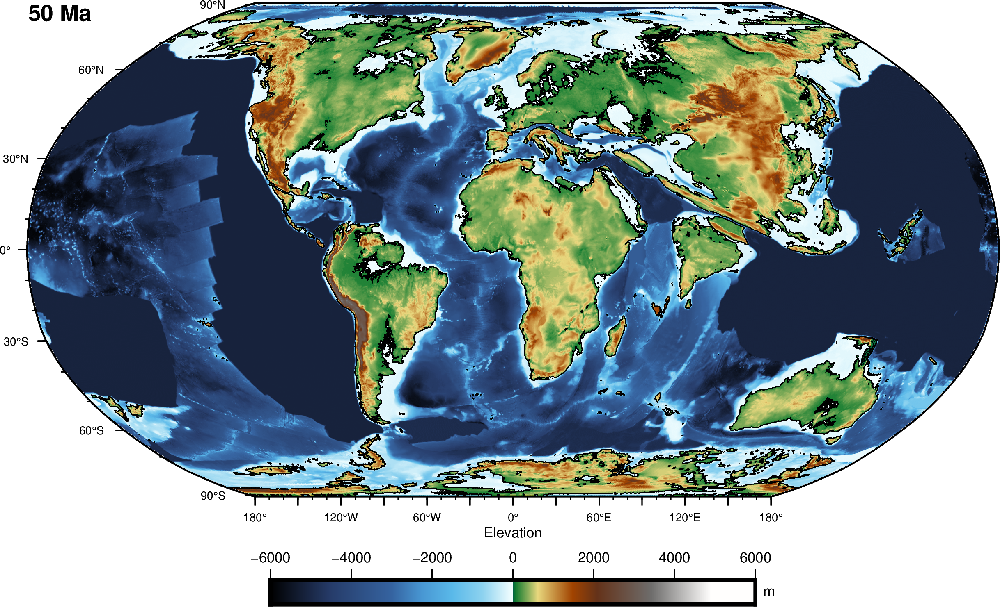

In [4]:
fig = pygmt.Figure()

# Plotting elevation
with pygmt.config(FONT='4p,Helvetica,black'):
    pygmt.makecpt(cmap="geo", series=[-6000, 6000])
    fig.basemap(region='d', projection='N12c', frame='afg')
    fig.grdimage(dataset.elevation, shading='+a45+nt1', frame=False)
    
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset.elevation,
        limit=[-0.1, 0.1],
    )

# Add color bar
with pygmt.config(FONT='5p,Helvetica,black'):    
    fig.colorbar(position="jBC+o0c/-1.35c+w6c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])

# At time step
fig.text(text=str(time)+" Ma", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")

fig.show(dpi=500, width=1000)

### Mollweide projection

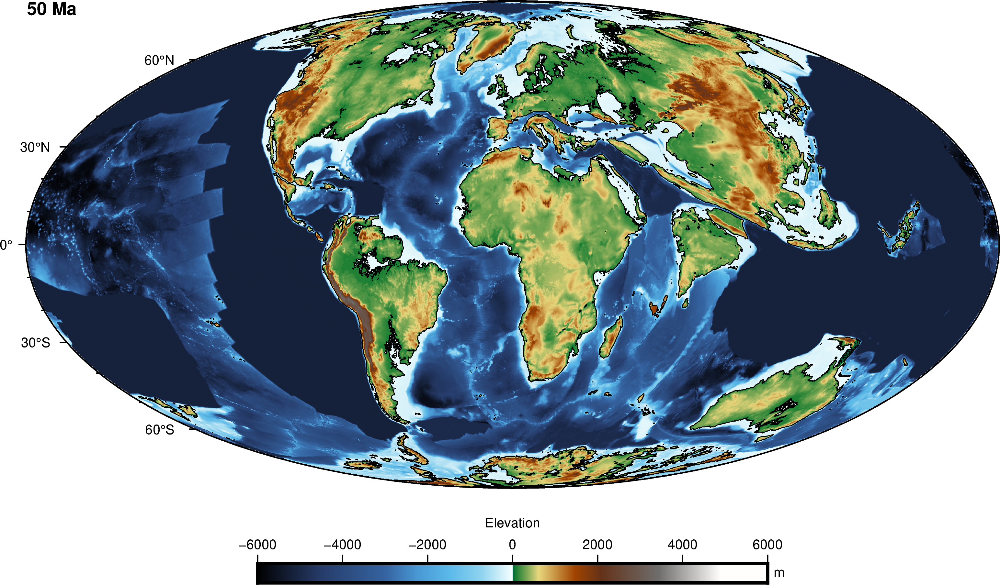

In [6]:
fig = pygmt.Figure()

# Plotting elevation
with pygmt.config(FONT='6p,Helvetica,black'):
    pygmt.makecpt(cmap="geo", series=[-6000, 6000])
    fig.basemap(region='d', projection='W6i', frame='afg')
    fig.grdimage(dataset.elevation, shading='+a345+nt1+m0', frame=False)
    
    # Add contour
    fig.grdcontour(
        interval=0.1,
        grid=dataset.elevation,
        limit=[-0.1, 0.1],
    )
    fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])
    

# Customising the font style
fig.text(text=str(time)+" Ma", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")

fig.show(dpi=500, width=1000)

Let us save all the elevations for a specific simulation to make a movie as the one presented in the github repository

In [ ]:
times = np.arange(95,-5,-5)
for k in range(len(times)):
    step = times[k]
    dataset = xr.open_dataset(out_path+'/data'+str(step)+'Ma.nc')

    fig = pygmt.Figure()

    with pygmt.config(FONT='6p,Helvetica,black'):
        pygmt.makecpt(cmap="geo", series=[-6000, 6000])
        fig.basemap(region='d', projection='W6i', frame='afg')
        fig.grdimage(dataset.elevation, shading=True, frame=False)
        fig.grdcontour(
    #         annotation=1000,
            interval=0.1,
            grid=dataset.elevation,
            limit=[-0.1, 0.1],
        )
        fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])

    # Customising the font style
    fig.text(text=str(step)+" Ma", position="TL", font="8p,Helvetica-Bold,black") #, xshift="-0.75c")
    
    fname = out_path+'/elev'+str(step)+'Ma.png'
    fig.savefig(fname=fname,dpi=500)

We can now make a movie out of these figures

In [ ]:
images = []
for k in range(95,-5,-5):
    filename = out_path+'/elev'+str(k)+'Ma.png'
    images.append(imageio.imread(filename))
    
imageio.mimsave(out_path+'/elevation.mp4', images, fps=1)

## Misc

Testing plots with hillshading effect, not sure it looks better than the previous one...

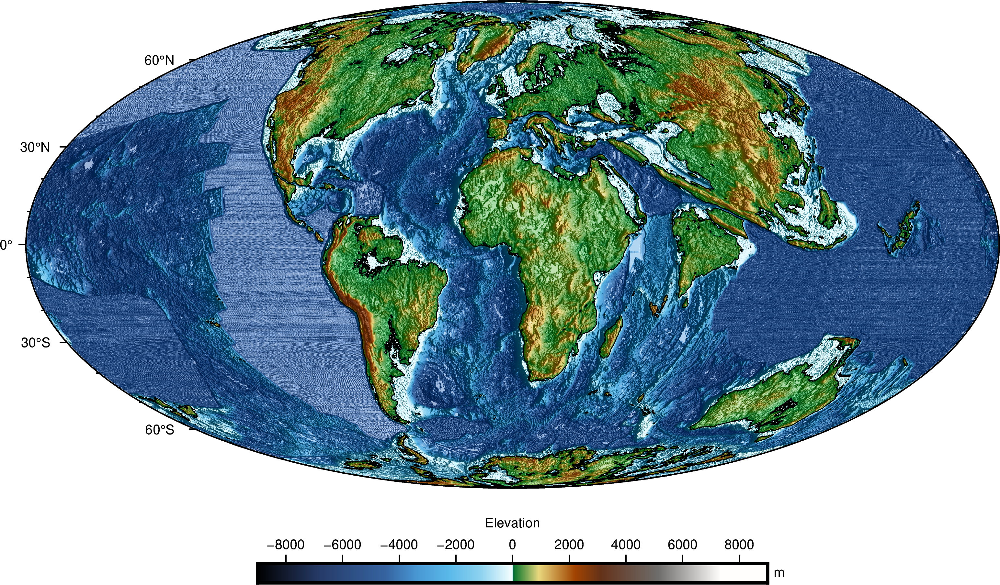

In [7]:
step = 50
dataset = xr.open_dataset(out_path+'/data'+str(step)+'Ma.nc')


# Define the radiance using the grdgradient from pygmt
grid = dataset.elevation 
dgrid = pygmt.grdgradient(grid=grid, 
                          radiance=[-270, 30, 0.01, 10000000],)

# Let us plot the data
fig = pygmt.Figure()
pygmt.config(FONT='6p,Helvetica,black') 

pygmt.makecpt(cmap="geo", series=[-9000, 9000])

fig.basemap(region='d', projection='W6i', frame='afg')

fig.grdimage(
    grid=grid,
    shading = dgrid,
    frame=False
)

# Add contour
fig.grdcontour(
        interval=0.1,
        grid=grid,
        limit=[-0.1, 0.1],
    )

fig.colorbar(position="jBC+o0c/-1.5c+w8c/0.3c+h",frame=["a2000", "x+lElevation", "y+lm"])

fig.show(dpi=500, width=1000)